#### Name - Aakash Jain.
#### Roll No. - 222010019.
#### Subject - Data Mining Lab.
#### Assignment No. 6: Use each of the dataset to cluster  using the following clustering techniques:
<hr />

a) Kmeans
b) KMedoids
c) Agglomerative Hierarchical clustering (use min, max and group average similarities)
d) DBSCAN 
e) spectral clustering

Evaluate the thus created clusters using the following evaluation metric 
a) Rand index
b) Mutual Information based scores
c) V-measure

d)  Silhouette Coefficient
e) Calinski-Harabasz Index
f) Davies-Bouldin Index

* First use elbow method to identify the number of clusters
* check for null values
* give brief statistics for each dataset
* preprocess the data if needed

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [3]:
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, SpectralClustering
from sklearn_extra.cluster import KMedoids
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics import adjusted_rand_score, mutual_info_score, silhouette_score, davies_bouldin_score
from sklearn.metrics.cluster import v_measure_score
from itertools import combinations

In [4]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
df = pd.read_csv('./datasets/design.csv')
df

,x,y,color
0,281.762010,186.024837,1
1,212.503675,199.031585,0
2,180.014894,259.379059,0
3,302.372404,284.465182,0
4,328.759727,176.945517,1
...,...,...,...
9320,303.398150,333.477029,0
9321,308.020662,320.375773,0
9322,326.646391,205.701014,1
9323,397.409261,178.919871,1


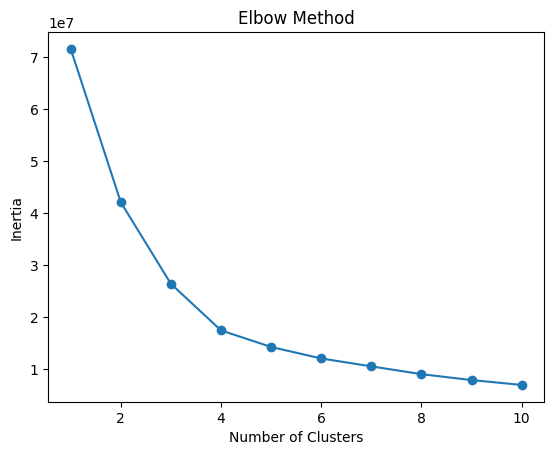

In [6]:
X = df[['x', 'y']].values

max_clusters = 10
inertia = []

for k in range(1, max_clusters + 1):
    kmeans = KMeans(n_clusters=k, random_state=0)
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)

plt.plot(range(1, max_clusters + 1), inertia, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method')
plt.show()

In [7]:
features = df[['x', 'y']]

num_clusters = 4 # From elbow method.

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(features)
cluster_labels = kmeans.labels_
df['kmeans'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='kmeans', title='K-means Clustering')
fig.show()


               x           y  color  kmeans
0     281.762010  186.024837      1       2
1     212.503675  199.031585      0       3
2     180.014894  259.379059      0       3
3     302.372404  284.465182      0       1
4     328.759727  176.945517      1       0
...          ...         ...    ...     ...
9320  303.398150  333.477029      0       1
9321  308.020662  320.375773      0       1
9322  326.646391  205.701014      1       0
9323  397.409261  178.919871      1       0
9324  257.146540  242.274809      0       3

[9325 rows x 4 columns]


In [8]:
import plotly.express as px
fig = px.scatter(df, x='x', y='y', color='color', title='Ground truth')
fig.show()

In [9]:
kmedoids = KMedoids(n_clusters=num_clusters, random_state=0)

kmedoids.fit(features)

cluster_labels = kmedoids.labels_
medoid_indices = kmedoids.medoid_indices_

df['kmedoid'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='kmedoid', title='K-medoids')
fig.show()


               x           y  color  kmeans  kmedoid
0     281.762010  186.024837      1       2        2
1     212.503675  199.031585      0       3        1
2     180.014894  259.379059      0       3        1
3     302.372404  284.465182      0       1        3
4     328.759727  176.945517      1       0        0
...          ...         ...    ...     ...      ...
9320  303.398150  333.477029      0       1        3
9321  308.020662  320.375773      0       1        3
9322  326.646391  205.701014      1       0        0
9323  397.409261  178.919871      1       0        0
9324  257.146540  242.274809      0       3        1

[9325 rows x 5 columns]


In [12]:
distances = pdist(features)
distance_matrix = squareform(distances)
linkage_methods = ['single', 'complete', 'average']

for linkage_method in linkage_methods:
    clustering = AgglomerativeClustering(n_clusters=4, affinity='precomputed', linkage=linkage_method)
    clustering.fit(distance_matrix)
    cluster_labels = clustering.labels_
    df['cluster_' + linkage_method] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='cluster_single', title='cluster_single')
fig.show()
fig = px.scatter(df, x='x', y='y', color='cluster_complete', title='cluster_complete')
fig.show()
fig = px.scatter(df, x='x', y='y', color='cluster_average', title='cluster_average')
fig.show()


(9325, 2) (43473150,)
[[  0.          70.46908889 125.43252153 ...  49.0077504  115.86529757
   61.40016843]
 [ 70.46908889   0.          68.53713275 ... 114.33739972 185.99612045
   62.15272984]
 [125.43252153  68.53713275   0.         ... 156.1477772  231.80593505
   79.0053548 ]
 ...
 [ 49.0077504  114.33739972 156.1477772  ...   0.          75.6611748
   78.53579937]
 [115.86529757 185.99612045 231.80593505 ...  75.6611748    0.
  153.9073717 ]
 [ 61.40016843  62.15272984  79.0053548  ...  78.53579937 153.9073717
    0.        ]]
               x           y  color  kmeans  kmedoid  cluster_single   
0     281.762010  186.024837      1       2        2               0  \
1     212.503675  199.031585      0       3        1               0   
2     180.014894  259.379059      0       3        1               0   
3     302.372404  284.465182      0       1        3               0   
4     328.759727  176.945517      1       0        0               0   
...          ...         ...

In [10]:
eps = 6
min_samples = 10 

dbscan = DBSCAN(eps=eps, min_samples=min_samples)

dbscan.fit(features)

cluster_labels = dbscan.labels_

df['dbscan'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='dbscan', title='dbscan')
fig.show()


               x           y  color  kmeans  kmedoid  cluster_single   
0     281.762010  186.024837      1       1        2               0  \
1     212.503675  199.031585      0       0        1               0   
2     180.014894  259.379059      0       0        1               0   
3     302.372404  284.465182      0       3        3               0   
4     328.759727  176.945517      1       2        0               0   
...          ...         ...    ...     ...      ...             ...   
9320  303.398150  333.477029      0       3        3               0   
9321  308.020662  320.375773      0       3        3               0   
9322  326.646391  205.701014      1       2        0               0   
9323  397.409261  178.919871      1       2        0               0   
9324  257.146540  242.274809      0       0        1               0   

      cluster_complete  cluster_average  dbscan  
0                    0                3       0  
1                    2             

In [11]:
n_clusters = 2 

features = df[['x', 'y']]

n_clusters = 4

spectral_clustering = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=0)

cluster_labels = spectral_clustering.fit_predict(features)

df['spectralclustering'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='spectralclustering', title='spectralclustering')
fig.show()


               x           y  color  kmeans  kmedoid  cluster_single   
0     281.762010  186.024837      1       1        2               0  \
1     212.503675  199.031585      0       0        1               0   
2     180.014894  259.379059      0       0        1               0   
3     302.372404  284.465182      0       3        3               0   
4     328.759727  176.945517      1       2        0               0   
...          ...         ...    ...     ...      ...             ...   
9320  303.398150  333.477029      0       3        3               0   
9321  308.020662  320.375773      0       3        3               0   
9322  326.646391  205.701014      1       2        0               0   
9323  397.409261  178.919871      1       2        0               0   
9324  257.146540  242.274809      0       0        1               0   

      cluster_complete  cluster_average  dbscan  spectralclustering  
0                    0                3       0                  

In [12]:
true_labels = df['color'].values
predicted_labels = df['kmeans'].values
rand_index = adjusted_rand_score(true_labels, predicted_labels)

print("Rand Index:", rand_index)
clustering_columns = ['color', 'kmeans', 'kmedoid', 'cluster_single',
                      'cluster_complete', 'cluster_average', 'dbscan',
                      'spectralclustering']

matrix_size = len(clustering_columns)
rand_index_matrix = [[0] * matrix_size for _ in range(matrix_size)]

for i in range(matrix_size):
    for j in range(i, matrix_size):
        column_i = df[clustering_columns[i]]
        column_j = df[clustering_columns[j]]
        rand_index = adjusted_rand_score(column_i, column_j)
        rand_index_matrix[i][j] = rand_index
        rand_index_matrix[j][i] = rand_index

rand_index_df = pd.DataFrame(rand_index_matrix, columns=clustering_columns, index=clustering_columns)

print(rand_index_df)


Rand Index: 0.4511614475993016
                       color    kmeans   kmedoid  cluster_single   
color               1.000000  0.451161  0.452586       -0.000013  \
kmeans              0.451161  1.000000  0.956478        0.000131   
kmedoid             0.452586  0.956478  1.000000        0.000118   
cluster_single     -0.000013  0.000131  0.000118        1.000000   
cluster_complete    0.468533  0.449921  0.443103        0.000284   
cluster_average     0.635032  0.632140  0.628850        0.000066   
dbscan              0.970365  0.452388  0.453799        0.001572   
spectralclustering  0.522519  0.845485  0.830491        0.000214   

                    cluster_complete  cluster_average    dbscan   
color                       0.468533         0.635032  0.970365  \
kmeans                      0.449921         0.632140  0.452388   
kmedoid                     0.443103         0.628850  0.453799   
cluster_single              0.000284         0.000066  0.001572   
cluster_complete     

In [13]:
matrix_size = len(clustering_columns)
mi_matrix = [[0] * matrix_size for _ in range(matrix_size)]

for i, j in combinations(range(matrix_size), 2):
    column_i = df[clustering_columns[i]]
    column_j = df[clustering_columns[j]]
    mi_score = mutual_info_score(column_i, column_j)
    mi_matrix[i][j] = mi_score
    mi_matrix[j][i] = mi_score

mi_df = pd.DataFrame(mi_matrix, columns=clustering_columns, index=clustering_columns)

print(mi_df)

                       color    kmeans   kmedoid  cluster_single   
color               0.000000  0.548238  0.556533        0.000294  \
kmeans              0.548238  0.000000  1.292805        0.000689   
kmedoid             0.556533  1.292805  0.000000        0.000680   
cluster_single      0.000294  0.000689  0.000680        0.000000   
cluster_complete    0.504172  0.746567  0.743648        0.000777   
cluster_average     0.687947  0.862234  0.868291        0.000622   
dbscan              0.681921  0.553488  0.562356        0.001817   
spectralclustering  0.661717  1.115212  1.104977        0.000744   

                    cluster_complete  cluster_average    dbscan   
color                       0.504172         0.687947  0.681921  \
kmeans                      0.746567         0.862234  0.553488   
kmedoid                     0.743648         0.868291  0.562356   
cluster_single              0.000777         0.000622  0.001817   
cluster_complete            0.000000         0.69187

In [14]:
color_labels = df['color'].tolist()

kmeans_labels = df['kmeans'].tolist()
kmedoid_labels = df['kmedoid'].tolist()
cluster_single_labels = df['cluster_single'].tolist()
cluster_complete_labels = df['cluster_complete'].tolist()
cluster_average_labels = df['cluster_average'].tolist()
dbscan_labels = df['dbscan'].tolist()
spectral_labels = df['spectralclustering'].tolist()

v_measure_kmeans = v_measure_score(color_labels, kmeans_labels)
v_measure_kmedoid = v_measure_score(color_labels, kmedoid_labels)
v_measure_cluster_single = v_measure_score(color_labels, cluster_single_labels)
v_measure_cluster_complete = v_measure_score(color_labels, cluster_complete_labels)
v_measure_cluster_average = v_measure_score(color_labels, cluster_average_labels)
v_measure_dbscan = v_measure_score(color_labels, dbscan_labels)
v_measure_spectral = v_measure_score(color_labels, spectral_labels)

print("V-measure for K-means: ", v_measure_kmeans)
print("V-measure for K-medoid: ", v_measure_kmedoid)
print("V-measure for Single Linkage: ", v_measure_cluster_single)
print("V-measure for Complete Linkage: ", v_measure_cluster_complete)
print("V-measure for Average Linkage: ", v_measure_cluster_average)
print("V-measure for DBSCAN: ", v_measure_dbscan)
print("V-measure for Spectral Clustering: ", v_measure_spectral)

V-measure for K-means:  0.5312324444526355
V-measure for K-medoid:  0.5386734232228846
V-measure for Single Linkage:  0.0008435318293562797
V-measure for Complete Linkage:  0.5003266511547899
V-measure for Average Linkage:  0.7130057666715954
V-measure for DBSCAN:  0.9389724885880837
V-measure for Spectral Clustering:  0.6479304752806361


In [15]:
silhouette_kmeans = silhouette_score(df, kmeans_labels)
silhouette_kmedoid = silhouette_score(df, kmedoid_labels)
silhouette_cluster_single = silhouette_score(df, cluster_single_labels)
silhouette_cluster_complete = silhouette_score(df, cluster_complete_labels)
silhouette_cluster_average = silhouette_score(df, cluster_average_labels)
silhouette_dbscan = silhouette_score(df, dbscan_labels)
silhouette_spectral = silhouette_score(df, spectral_labels)

print("Silhouette Coefficient for K-means: ", silhouette_kmeans)
print("Silhouette Coefficient for K-medoid: ", silhouette_kmedoid)
print("Silhouette Coefficient for Single Linkage: ", silhouette_cluster_single)
print("Silhouette Coefficient for Complete Linkage: ", silhouette_cluster_complete)
print("Silhouette Coefficient for Average Linkage: ", silhouette_cluster_average)
print("Silhouette Coefficient for DBSCAN: ", silhouette_dbscan)
print("Silhouette Coefficient for Spectral Clustering: ", silhouette_spectral)

Silhouette Coefficient for K-means:  0.4269334905497059
Silhouette Coefficient for K-medoid:  0.42733095965972734
Silhouette Coefficient for Single Linkage:  -0.11537913320184318
Silhouette Coefficient for Complete Linkage:  0.31297770171427103
Silhouette Coefficient for Average Linkage:  0.36695132161332084
Silhouette Coefficient for DBSCAN:  0.3242913359626314
Silhouette Coefficient for Spectral Clustering:  0.42416622932565473


In [16]:
from sklearn.metrics import calinski_harabasz_score

calinski_kmeans = calinski_harabasz_score(df, kmeans_labels)
calinski_kmedoid = calinski_harabasz_score(df, kmedoid_labels)
calinski_cluster_single = calinski_harabasz_score(df, cluster_single_labels)
calinski_cluster_complete = calinski_harabasz_score(df, cluster_complete_labels)
calinski_cluster_average = calinski_harabasz_score(df, cluster_average_labels)
calinski_dbscan = calinski_harabasz_score(df, dbscan_labels)
calinski_spectral = calinski_harabasz_score(df, spectral_labels)

print("Calinski-Harabasz Index for K-means: ", calinski_kmeans)
print("Calinski-Harabasz Index for K-medoid: ", calinski_kmedoid)
print("Calinski-Harabasz Index for Single Linkage: ", calinski_cluster_single)
print("Calinski-Harabasz Index for Complete Linkage: ", calinski_cluster_complete)
print("Calinski-Harabasz Index for Average Linkage: ", calinski_cluster_average)
print("Calinski-Harabasz Index for DBSCAN: ", calinski_dbscan)
print("Calinski-Harabasz Index for Spectral Clustering: ", calinski_spectral)

Calinski-Harabasz Index for K-means:  9605.579626575602
Calinski-Harabasz Index for K-medoid:  9595.71965817739
Calinski-Harabasz Index for Single Linkage:  3.39458371265856
Calinski-Harabasz Index for Complete Linkage:  6043.236753678249
Calinski-Harabasz Index for Average Linkage:  6801.758956764544
Calinski-Harabasz Index for DBSCAN:  3048.8343803704374
Calinski-Harabasz Index for Spectral Clustering:  9174.362895013935


In [17]:
davies_bouldin_kmeans = davies_bouldin_score(df, kmeans_labels)
davies_bouldin_kmedoid = davies_bouldin_score(df, kmedoid_labels)
davies_bouldin_cluster_single = davies_bouldin_score(df, cluster_single_labels)
davies_bouldin_cluster_complete = davies_bouldin_score(df, cluster_complete_labels)
davies_bouldin_cluster_average = davies_bouldin_score(df, cluster_average_labels)
davies_bouldin_dbscan = davies_bouldin_score(df, dbscan_labels)
davies_bouldin_spectral = davies_bouldin_score(df, spectral_labels)

print("Davies-Bouldin Index for K-means: ", davies_bouldin_kmeans)
print("Davies-Bouldin Index for K-medoid: ", davies_bouldin_kmedoid)
print("Davies-Bouldin Index for Single Linkage: ", davies_bouldin_cluster_single)
print("Davies-Bouldin Index for Complete Linkage: ", davies_bouldin_cluster_complete)
print("Davies-Bouldin Index for Average Linkage: ", davies_bouldin_cluster_average)
print("Davies-Bouldin Index for DBSCAN: ", davies_bouldin_dbscan)
print("Davies-Bouldin Index for Spectral Clustering: ", davies_bouldin_spectral)

Davies-Bouldin Index for K-means:  0.7601449676341344
Davies-Bouldin Index for K-medoid:  0.7618824374503168
Davies-Bouldin Index for Single Linkage:  0.6026283579178089
Davies-Bouldin Index for Complete Linkage:  0.9958010028756665
Davies-Bouldin Index for Average Linkage:  0.7278057477356943
Davies-Bouldin Index for DBSCAN:  2.7010973192892584
Davies-Bouldin Index for Spectral Clustering:  0.7455347521567613


In [18]:
df = pd.read_csv('./datasets/concentric_circle.csv')
df

,x,y,color
0,279.925027,310.327844,3
1,402.967849,84.953838,3
2,432.899756,241.304197,3
3,355.766547,72.821111,3
4,320.429621,240.766330,1
...,...,...,...
6733,250.313080,115.192909,0
6734,205.217905,90.845159,3
6735,311.834185,201.448346,2
6736,295.157920,272.465784,0


In [19]:
features = df[['x', 'y']]

num_clusters = 4 # From elbow method.

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(features)
cluster_labels = kmeans.labels_
df['kmeans'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='kmeans', title='K-means Clustering')
fig.show()


               x           y  color  kmeans
0     279.925027  310.327844      3       1
1     402.967849   84.953838      3       3
2     432.899756  241.304197      3       1
3     355.766547   72.821111      3       3
4     320.429621  240.766330      1       1
...          ...         ...    ...     ...
6733  250.313080  115.192909      0       0
6734  205.217905   90.845159      3       0
6735  311.834185  201.448346      2       1
6736  295.157920  272.465784      0       1
6737  273.142957  161.169179      1       0

[6738 rows x 4 columns]


In [20]:
import plotly.express as px
fig = px.scatter(df, x='x', y='y', color='color', title='Ground truth')
fig.show()

In [21]:
kmedoids = KMedoids(n_clusters=num_clusters, random_state=0)

kmedoids.fit(features)

cluster_labels = kmedoids.labels_
medoid_indices = kmedoids.medoid_indices_

df['kmedoid'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='kmedoid', title='K-medoids')
fig.show()


               x           y  color  kmeans  kmedoid
0     279.925027  310.327844      3       1        1
1     402.967849   84.953838      3       3        0
2     432.899756  241.304197      3       1        0
3     355.766547   72.821111      3       3        0
4     320.429621  240.766330      1       1        1
...          ...         ...    ...     ...      ...
6733  250.313080  115.192909      0       0        2
6734  205.217905   90.845159      3       0        2
6735  311.834185  201.448346      2       1        1
6736  295.157920  272.465784      0       1        1
6737  273.142957  161.169179      1       0        2

[6738 rows x 5 columns]


In [22]:
distances = pdist(features)
distance_matrix = squareform(distances)
linkage_methods = ['single', 'complete', 'average']

for linkage_method in linkage_methods:
    clustering = AgglomerativeClustering(n_clusters=4, affinity='precomputed', linkage=linkage_method)
    clustering.fit(distance_matrix)
    cluster_labels = clustering.labels_
    df['cluster_' + linkage_method] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='cluster_single', title='cluster_single')
fig.show()
fig = px.scatter(df, x='x', y='y', color='cluster_complete', title='cluster_complete')
fig.show()
fig = px.scatter(df, x='x', y='y', color='cluster_average', title='cluster_average')
fig.show()


               x           y  color  kmeans  kmedoid  cluster_single   
0     279.925027  310.327844      3       1        1               0  \
1     402.967849   84.953838      3       3        0               0   
2     432.899756  241.304197      3       1        0               0   
3     355.766547   72.821111      3       3        0               0   
4     320.429621  240.766330      1       1        1               3   
...          ...         ...    ...     ...      ...             ...   
6733  250.313080  115.192909      0       0        2               1   
6734  205.217905   90.845159      3       0        2               0   
6735  311.834185  201.448346      2       1        1               2   
6736  295.157920  272.465784      0       1        1               1   
6737  273.142957  161.169179      1       0        2               3   

      cluster_complete  cluster_average  
0                    0                2  
1                    1                3  
2        

In [23]:
eps = 6
min_samples = 10 

dbscan = DBSCAN(eps=eps, min_samples=min_samples)

dbscan.fit(features)

cluster_labels = dbscan.labels_

df['dbscan'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='dbscan', title='dbscan')
fig.show()


               x           y  color  kmeans  kmedoid  cluster_single   
0     279.925027  310.327844      3       1        1               0  \
1     402.967849   84.953838      3       3        0               0   
2     432.899756  241.304197      3       1        0               0   
3     355.766547   72.821111      3       3        0               0   
4     320.429621  240.766330      1       1        1               3   
...          ...         ...    ...     ...      ...             ...   
6733  250.313080  115.192909      0       0        2               1   
6734  205.217905   90.845159      3       0        2               0   
6735  311.834185  201.448346      2       1        1               2   
6736  295.157920  272.465784      0       1        1               1   
6737  273.142957  161.169179      1       0        2               3   

      cluster_complete  cluster_average  dbscan  
0                    0                2      -1  
1                    1             

In [24]:
n_clusters = 2 

features = df[['x', 'y']]

n_clusters = 4

spectral_clustering = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=0)

cluster_labels = spectral_clustering.fit_predict(features)

df['spectralclustering'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='spectralclustering', title='spectralclustering')
fig.show()


               x           y  color  kmeans  kmedoid  cluster_single   
0     279.925027  310.327844      3       1        1               0  \
1     402.967849   84.953838      3       3        0               0   
2     432.899756  241.304197      3       1        0               0   
3     355.766547   72.821111      3       3        0               0   
4     320.429621  240.766330      1       1        1               3   
...          ...         ...    ...     ...      ...             ...   
6733  250.313080  115.192909      0       0        2               1   
6734  205.217905   90.845159      3       0        2               0   
6735  311.834185  201.448346      2       1        1               2   
6736  295.157920  272.465784      0       1        1               1   
6737  273.142957  161.169179      1       0        2               3   

      cluster_complete  cluster_average  dbscan  spectralclustering  
0                    0                2      -1                  

In [25]:
true_labels = df['color'].values
predicted_labels = df['kmeans'].values
rand_index = adjusted_rand_score(true_labels, predicted_labels)

print("Rand Index:", rand_index)
clustering_columns = ['color', 'kmeans', 'kmedoid', 'cluster_single',
                      'cluster_complete', 'cluster_average', 'dbscan',
                      'spectralclustering']

matrix_size = len(clustering_columns)
rand_index_matrix = [[0] * matrix_size for _ in range(matrix_size)]

for i in range(matrix_size):
    for j in range(i, matrix_size):
        column_i = df[clustering_columns[i]]
        column_j = df[clustering_columns[j]]
        rand_index = adjusted_rand_score(column_i, column_j)
        rand_index_matrix[i][j] = rand_index
        rand_index_matrix[j][i] = rand_index

rand_index_df = pd.DataFrame(rand_index_matrix, columns=clustering_columns, index=clustering_columns)

print(rand_index_df)


Rand Index: 0.007148655678238108
                       color    kmeans   kmedoid  cluster_single   
color               1.000000  0.007149  0.006033        1.000000  \
kmeans              0.007149  1.000000  0.803778        0.007149   
kmedoid             0.006033  0.803778  1.000000        0.006033   
cluster_single      1.000000  0.007149  0.006033        1.000000   
cluster_complete    0.003975  0.346534  0.308166        0.003975   
cluster_average     0.040244  0.523155  0.544044        0.040244   
dbscan              0.702524  0.080108  0.076353        0.702524   
spectralclustering  1.000000  0.007149  0.006033        1.000000   

                    cluster_complete  cluster_average    dbscan   
color                       0.003975         0.040244  0.702524  \
kmeans                      0.346534         0.523155  0.080108   
kmedoid                     0.308166         0.544044  0.076353   
cluster_single              0.003975         0.040244  0.702524   
cluster_complete   

In [26]:
matrix_size = len(clustering_columns)
mi_matrix = [[0] * matrix_size for _ in range(matrix_size)]

for i, j in combinations(range(matrix_size), 2):
    column_i = df[clustering_columns[i]]
    column_j = df[clustering_columns[j]]
    mi_score = mutual_info_score(column_i, column_j)
    mi_matrix[i][j] = mi_score
    mi_matrix[j][i] = mi_score

mi_df = pd.DataFrame(mi_matrix, columns=clustering_columns, index=clustering_columns)

print(mi_df)

                       color    kmeans   kmedoid  cluster_single   
color               0.000000  0.064141  0.043380        1.219746  \
kmeans              0.064141  0.000000  1.092342        0.064141   
kmedoid             0.043380  1.092342  0.000000        0.043380   
cluster_single      1.219746  0.064141  0.043380        0.000000   
cluster_complete    0.112070  0.628452  0.583140        0.112070   
cluster_average     0.184287  0.765763  0.792779        0.184287   
dbscan              1.203618  0.388846  0.362832        1.203618   
spectralclustering  1.219746  0.064141  0.043380        1.219746   

                    cluster_complete  cluster_average    dbscan   
color                       0.112070         0.184287  1.203618  \
kmeans                      0.628452         0.765763  0.388846   
kmedoid                     0.583140         0.792779  0.362832   
cluster_single              0.112070         0.184287  1.203618   
cluster_complete            0.000000         0.45422

In [27]:
color_labels = df['color'].tolist()

kmeans_labels = df['kmeans'].tolist()
kmedoid_labels = df['kmedoid'].tolist()
cluster_single_labels = df['cluster_single'].tolist()
cluster_complete_labels = df['cluster_complete'].tolist()
cluster_average_labels = df['cluster_average'].tolist()
dbscan_labels = df['dbscan'].tolist()
spectral_labels = df['spectralclustering'].tolist()

v_measure_kmeans = v_measure_score(color_labels, kmeans_labels)
v_measure_kmedoid = v_measure_score(color_labels, kmedoid_labels)
v_measure_cluster_single = v_measure_score(color_labels, cluster_single_labels)
v_measure_cluster_complete = v_measure_score(color_labels, cluster_complete_labels)
v_measure_cluster_average = v_measure_score(color_labels, cluster_average_labels)
v_measure_dbscan = v_measure_score(color_labels, dbscan_labels)
v_measure_spectral = v_measure_score(color_labels, spectral_labels)

print("V-measure for K-means: ", v_measure_kmeans)
print("V-measure for K-medoid: ", v_measure_kmedoid)
print("V-measure for Single Linkage: ", v_measure_cluster_single)
print("V-measure for Complete Linkage: ", v_measure_cluster_complete)
print("V-measure for Average Linkage: ", v_measure_cluster_average)
print("V-measure for DBSCAN: ", v_measure_dbscan)
print("V-measure for Spectral Clustering: ", v_measure_spectral)

V-measure for K-means:  0.04937738761000049
V-measure for K-medoid:  0.033348707534406344
V-measure for Single Linkage:  1.0
V-measure for Complete Linkage:  0.09006577366021747
V-measure for Average Linkage:  0.14655734201899984
V-measure for DBSCAN:  0.7752027933670204
V-measure for Spectral Clustering:  1.0000000000000002


In [28]:
silhouette_kmeans = silhouette_score(df, kmeans_labels)
silhouette_kmedoid = silhouette_score(df, kmedoid_labels)
silhouette_cluster_single = silhouette_score(df, cluster_single_labels)
silhouette_cluster_complete = silhouette_score(df, cluster_complete_labels)
silhouette_cluster_average = silhouette_score(df, cluster_average_labels)
silhouette_dbscan = silhouette_score(df, dbscan_labels)
silhouette_spectral = silhouette_score(df, spectral_labels)

print("Silhouette Coefficient for K-means: ", silhouette_kmeans)
print("Silhouette Coefficient for K-medoid: ", silhouette_kmedoid)
print("Silhouette Coefficient for Single Linkage: ", silhouette_cluster_single)
print("Silhouette Coefficient for Complete Linkage: ", silhouette_cluster_complete)
print("Silhouette Coefficient for Average Linkage: ", silhouette_cluster_average)
print("Silhouette Coefficient for DBSCAN: ", silhouette_dbscan)
print("Silhouette Coefficient for Spectral Clustering: ", silhouette_spectral)

Silhouette Coefficient for K-means:  0.34852413374558844
Silhouette Coefficient for K-medoid:  0.34450259930480176
Silhouette Coefficient for Single Linkage:  -0.161668542451099
Silhouette Coefficient for Complete Linkage:  0.2689007335830378
Silhouette Coefficient for Average Linkage:  0.2908600218603421
Silhouette Coefficient for DBSCAN:  -0.24527311717439487
Silhouette Coefficient for Spectral Clustering:  -0.161668542451099


In [29]:
from sklearn.metrics import calinski_harabasz_score

calinski_kmeans = calinski_harabasz_score(df, kmeans_labels)
calinski_kmedoid = calinski_harabasz_score(df, kmedoid_labels)
calinski_cluster_single = calinski_harabasz_score(df, cluster_single_labels)
calinski_cluster_complete = calinski_harabasz_score(df, cluster_complete_labels)
calinski_cluster_average = calinski_harabasz_score(df, cluster_average_labels)
calinski_dbscan = calinski_harabasz_score(df, dbscan_labels)
calinski_spectral = calinski_harabasz_score(df, spectral_labels)

print("Calinski-Harabasz Index for K-means: ", calinski_kmeans)
print("Calinski-Harabasz Index for K-medoid: ", calinski_kmedoid)
print("Calinski-Harabasz Index for Single Linkage: ", calinski_cluster_single)
print("Calinski-Harabasz Index for Complete Linkage: ", calinski_cluster_complete)
print("Calinski-Harabasz Index for Average Linkage: ", calinski_cluster_average)
print("Calinski-Harabasz Index for DBSCAN: ", calinski_dbscan)
print("Calinski-Harabasz Index for Spectral Clustering: ", calinski_spectral)

Calinski-Harabasz Index for K-means:  5028.735917201024
Calinski-Harabasz Index for K-medoid:  4995.011370449351
Calinski-Harabasz Index for Single Linkage:  5.180526780837956
Calinski-Harabasz Index for Complete Linkage:  3704.4881753577397
Calinski-Harabasz Index for Average Linkage:  3820.077483165713
Calinski-Harabasz Index for DBSCAN:  371.39368590127685
Calinski-Harabasz Index for Spectral Clustering:  5.180526780837957


In [30]:
davies_bouldin_kmeans = davies_bouldin_score(df, kmeans_labels)
davies_bouldin_kmedoid = davies_bouldin_score(df, kmedoid_labels)
davies_bouldin_cluster_single = davies_bouldin_score(df, cluster_single_labels)
davies_bouldin_cluster_complete = davies_bouldin_score(df, cluster_complete_labels)
davies_bouldin_cluster_average = davies_bouldin_score(df, cluster_average_labels)
davies_bouldin_dbscan = davies_bouldin_score(df, dbscan_labels)
davies_bouldin_spectral = davies_bouldin_score(df, spectral_labels)

print("Davies-Bouldin Index for K-means: ", davies_bouldin_kmeans)
print("Davies-Bouldin Index for K-medoid: ", davies_bouldin_kmedoid)
print("Davies-Bouldin Index for Single Linkage: ", davies_bouldin_cluster_single)
print("Davies-Bouldin Index for Complete Linkage: ", davies_bouldin_cluster_complete)
print("Davies-Bouldin Index for Average Linkage: ", davies_bouldin_cluster_average)
print("Davies-Bouldin Index for DBSCAN: ", davies_bouldin_dbscan)
print("Davies-Bouldin Index for Spectral Clustering: ", davies_bouldin_spectral)

Davies-Bouldin Index for K-means:  0.8838800012234154
Davies-Bouldin Index for K-medoid:  0.8864259782297514
Davies-Bouldin Index for Single Linkage:  25.67352855243681
Davies-Bouldin Index for Complete Linkage:  0.899592252014406
Davies-Bouldin Index for Average Linkage:  0.891562455292877
Davies-Bouldin Index for DBSCAN:  4.361170119349646
Davies-Bouldin Index for Spectral Clustering:  25.673528552436807


In [31]:
df = pd.read_csv('./datasets/cubes.csv')
df

,x,y,color
0,490.127172,115.109548,1
1,294.267870,158.581321,0
2,440.425055,203.140844,2
3,494.372291,112.077622,1
4,316.361087,238.759800,1
...,...,...,...
11266,393.913279,137.685359,1
11267,483.317363,298.840628,2
11268,467.365554,131.836571,1
11269,352.272336,104.748717,0


In [32]:
features = df[['x', 'y']]

num_clusters = 4 # From elbow method.

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(features)
cluster_labels = kmeans.labels_
df['kmeans'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='kmeans', title='K-means Clustering')
fig.show()


                x           y  color  kmeans
0      490.127172  115.109548      1       0
1      294.267870  158.581321      0       2
2      440.425055  203.140844      2       1
3      494.372291  112.077622      1       0
4      316.361087  238.759800      1       3
...           ...         ...    ...     ...
11266  393.913279  137.685359      1       0
11267  483.317363  298.840628      2       1
11268  467.365554  131.836571      1       0
11269  352.272336  104.748717      0       2
11270  382.758061  132.731063      1       2

[11271 rows x 4 columns]


In [33]:
import plotly.express as px
fig = px.scatter(df, x='x', y='y', color='color', title='Ground truth')
fig.show()

In [34]:
kmedoids = KMedoids(n_clusters=num_clusters, random_state=0)

kmedoids.fit(features)

cluster_labels = kmedoids.labels_
medoid_indices = kmedoids.medoid_indices_

df['kmedoid'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='kmedoid', title='K-medoids')
fig.show()


                x           y  color  kmeans  kmedoid
0      490.127172  115.109548      1       0        2
1      294.267870  158.581321      0       2        3
2      440.425055  203.140844      2       1        1
3      494.372291  112.077622      1       0        2
4      316.361087  238.759800      1       3        0
...           ...         ...    ...     ...      ...
11266  393.913279  137.685359      1       0        2
11267  483.317363  298.840628      2       1        1
11268  467.365554  131.836571      1       0        2
11269  352.272336  104.748717      0       2        3
11270  382.758061  132.731063      1       2        3

[11271 rows x 5 columns]


In [35]:
distances = pdist(features)
distance_matrix = squareform(distances)
linkage_methods = ['single', 'complete', 'average']

for linkage_method in linkage_methods:
    clustering = AgglomerativeClustering(n_clusters=4, affinity='precomputed', linkage=linkage_method)
    clustering.fit(distance_matrix)
    cluster_labels = clustering.labels_
    df['cluster_' + linkage_method] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='cluster_single', title='cluster_single')
fig.show()
fig = px.scatter(df, x='x', y='y', color='cluster_complete', title='cluster_complete')
fig.show()
fig = px.scatter(df, x='x', y='y', color='cluster_average', title='cluster_average')
fig.show()


                x           y  color  kmeans  kmedoid  cluster_single   
0      490.127172  115.109548      1       0        2               2  \
1      294.267870  158.581321      0       2        3               0   
2      440.425055  203.140844      2       1        1               1   
3      494.372291  112.077622      1       0        2               2   
4      316.361087  238.759800      1       3        0               2   
...           ...         ...    ...     ...      ...             ...   
11266  393.913279  137.685359      1       0        2               2   
11267  483.317363  298.840628      2       1        1               1   
11268  467.365554  131.836571      1       0        2               2   
11269  352.272336  104.748717      0       2        3               0   
11270  382.758061  132.731063      1       2        3               2   

       cluster_complete  cluster_average  
0                     3                2  
1                     1              

In [36]:
eps = 6
min_samples = 10 

dbscan = DBSCAN(eps=eps, min_samples=min_samples)

dbscan.fit(features)

cluster_labels = dbscan.labels_

df['dbscan'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='dbscan', title='dbscan')
fig.show()


                x           y  color  kmeans  kmedoid  cluster_single   
0      490.127172  115.109548      1       0        2               2  \
1      294.267870  158.581321      0       2        3               0   
2      440.425055  203.140844      2       1        1               1   
3      494.372291  112.077622      1       0        2               2   
4      316.361087  238.759800      1       3        0               2   
...           ...         ...    ...     ...      ...             ...   
11266  393.913279  137.685359      1       0        2               2   
11267  483.317363  298.840628      2       1        1               1   
11268  467.365554  131.836571      1       0        2               2   
11269  352.272336  104.748717      0       2        3               0   
11270  382.758061  132.731063      1       2        3               2   

       cluster_complete  cluster_average  dbscan  
0                     3                2       0  
1                    

In [37]:
n_clusters = 2 

features = df[['x', 'y']]

n_clusters = 4

spectral_clustering = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=0)

cluster_labels = spectral_clustering.fit_predict(features)

df['spectralclustering'] = cluster_labels

print(df)
fig = px.scatter(df, x='x', y='y', color='spectralclustering', title='spectralclustering')
fig.show()


                x           y  color  kmeans  kmedoid  cluster_single   
0      490.127172  115.109548      1       0        2               2  \
1      294.267870  158.581321      0       2        3               0   
2      440.425055  203.140844      2       1        1               1   
3      494.372291  112.077622      1       0        2               2   
4      316.361087  238.759800      1       3        0               2   
...           ...         ...    ...     ...      ...             ...   
11266  393.913279  137.685359      1       0        2               2   
11267  483.317363  298.840628      2       1        1               1   
11268  467.365554  131.836571      1       0        2               2   
11269  352.272336  104.748717      0       2        3               0   
11270  382.758061  132.731063      1       2        3               2   

       cluster_complete  cluster_average  dbscan  spectralclustering  
0                     3                2       0    

In [38]:
true_labels = df['color'].values
predicted_labels = df['kmeans'].values
rand_index = adjusted_rand_score(true_labels, predicted_labels)

print("Rand Index:", rand_index)
clustering_columns = ['color', 'kmeans', 'kmedoid', 'cluster_single',
                      'cluster_complete', 'cluster_average', 'dbscan',
                      'spectralclustering']

matrix_size = len(clustering_columns)
rand_index_matrix = [[0] * matrix_size for _ in range(matrix_size)]

for i in range(matrix_size):
    for j in range(i, matrix_size):
        column_i = df[clustering_columns[i]]
        column_j = df[clustering_columns[j]]
        rand_index = adjusted_rand_score(column_i, column_j)
        rand_index_matrix[i][j] = rand_index
        rand_index_matrix[j][i] = rand_index

rand_index_df = pd.DataFrame(rand_index_matrix, columns=clustering_columns, index=clustering_columns)

print(rand_index_df)


Rand Index: 0.3393324379992167
                       color    kmeans   kmedoid  cluster_single   
color               1.000000  0.339332  0.420088        0.999485  \
kmeans              0.339332  1.000000  0.842772        0.339252   
kmedoid             0.420088  0.842772  1.000000        0.419968   
cluster_single      0.999485  0.339252  0.419968        1.000000   
cluster_complete    0.317508  0.468022  0.454946        0.317420   
cluster_average     0.499553  0.484900  0.539688        0.499348   
dbscan              0.995018  0.339698  0.420616        0.995530   
spectralclustering  0.615531  0.605540  0.686307        0.615402   

                    cluster_complete  cluster_average    dbscan   
color                       0.317508         0.499553  0.995018  \
kmeans                      0.468022         0.484900  0.339698   
kmedoid                     0.454946         0.539688  0.420616   
cluster_single              0.317420         0.499348  0.995530   
cluster_complete     

In [39]:
matrix_size = len(clustering_columns)
mi_matrix = [[0] * matrix_size for _ in range(matrix_size)]

for i, j in combinations(range(matrix_size), 2):
    column_i = df[clustering_columns[i]]
    column_j = df[clustering_columns[j]]
    mi_score = mutual_info_score(column_i, column_j)
    mi_matrix[i][j] = mi_score
    mi_matrix[j][i] = mi_score

mi_df = pd.DataFrame(mi_matrix, columns=clustering_columns, index=clustering_columns)

print(mi_df)

                       color    kmeans   kmedoid  cluster_single   
color               0.000000  0.560888  0.631170        1.024183  \
kmeans              0.560888  0.000000  1.146295        0.561126   
kmedoid             0.631170  1.146295  0.000000        0.631374   
cluster_single      1.024183  0.561126  0.631374        0.000000   
cluster_complete    0.590159  0.751628  0.749591        0.590386   
cluster_average     0.790112  0.775759  0.830447        0.790258   
dbscan              1.021895  0.562571  0.633099        1.023439   
spectralclustering  0.873387  0.907579  0.980993        0.873557   

                    cluster_complete  cluster_average    dbscan   
color                       0.590159         0.790112  1.021895  \
kmeans                      0.751628         0.775759  0.562571   
kmedoid                     0.749591         0.830447  0.633099   
cluster_single              0.590386         0.790258  1.023439   
cluster_complete            0.000000         0.93892

In [40]:
color_labels = df['color'].tolist()

kmeans_labels = df['kmeans'].tolist()
kmedoid_labels = df['kmedoid'].tolist()
cluster_single_labels = df['cluster_single'].tolist()
cluster_complete_labels = df['cluster_complete'].tolist()
cluster_average_labels = df['cluster_average'].tolist()
dbscan_labels = df['dbscan'].tolist()
spectral_labels = df['spectralclustering'].tolist()

v_measure_kmeans = v_measure_score(color_labels, kmeans_labels)
v_measure_kmedoid = v_measure_score(color_labels, kmedoid_labels)
v_measure_cluster_single = v_measure_score(color_labels, cluster_single_labels)
v_measure_cluster_complete = v_measure_score(color_labels, cluster_complete_labels)
v_measure_cluster_average = v_measure_score(color_labels, cluster_average_labels)
v_measure_dbscan = v_measure_score(color_labels, dbscan_labels)
v_measure_spectral = v_measure_score(color_labels, spectral_labels)

print("V-measure for K-means: ", v_measure_kmeans)
print("V-measure for K-medoid: ", v_measure_kmedoid)
print("V-measure for Single Linkage: ", v_measure_cluster_single)
print("V-measure for Complete Linkage: ", v_measure_cluster_complete)
print("V-measure for Average Linkage: ", v_measure_cluster_average)
print("V-measure for DBSCAN: ", v_measure_dbscan)
print("V-measure for Spectral Clustering: ", v_measure_spectral)

V-measure for K-means:  0.46560603374220333
V-measure for K-medoid:  0.5245270491681548
V-measure for Single Linkage:  0.9989040242565972
V-measure for Complete Linkage:  0.5001621732587124
V-measure for Average Linkage:  0.6700681267557977
V-measure for DBSCAN:  0.9895858411610569
V-measure for Spectral Clustering:  0.7344487877454643


In [41]:
silhouette_kmeans = silhouette_score(df, kmeans_labels)
silhouette_kmedoid = silhouette_score(df, kmedoid_labels)
silhouette_cluster_single = silhouette_score(df, cluster_single_labels)
silhouette_cluster_complete = silhouette_score(df, cluster_complete_labels)
silhouette_cluster_average = silhouette_score(df, cluster_average_labels)
silhouette_dbscan = silhouette_score(df, dbscan_labels)
silhouette_spectral = silhouette_score(df, spectral_labels)

print("Silhouette Coefficient for K-means: ", silhouette_kmeans)
print("Silhouette Coefficient for K-medoid: ", silhouette_kmedoid)
print("Silhouette Coefficient for Single Linkage: ", silhouette_cluster_single)
print("Silhouette Coefficient for Complete Linkage: ", silhouette_cluster_complete)
print("Silhouette Coefficient for Average Linkage: ", silhouette_cluster_average)
print("Silhouette Coefficient for DBSCAN: ", silhouette_dbscan)
print("Silhouette Coefficient for Spectral Clustering: ", silhouette_spectral)

Silhouette Coefficient for K-means:  0.41467666313562007
Silhouette Coefficient for K-medoid:  0.4187603406120475
Silhouette Coefficient for Single Linkage:  0.15658929363697982
Silhouette Coefficient for Complete Linkage:  0.33038089187573316
Silhouette Coefficient for Average Linkage:  0.3852754810479938
Silhouette Coefficient for DBSCAN:  0.26177293922497646
Silhouette Coefficient for Spectral Clustering:  0.40437685780452015


In [42]:
from sklearn.metrics import calinski_harabasz_score

calinski_kmeans = calinski_harabasz_score(df, kmeans_labels)
calinski_kmedoid = calinski_harabasz_score(df, kmedoid_labels)
calinski_cluster_single = calinski_harabasz_score(df, cluster_single_labels)
calinski_cluster_complete = calinski_harabasz_score(df, cluster_complete_labels)
calinski_cluster_average = calinski_harabasz_score(df, cluster_average_labels)
calinski_dbscan = calinski_harabasz_score(df, dbscan_labels)
calinski_spectral = calinski_harabasz_score(df, spectral_labels)

print("Calinski-Harabasz Index for K-means: ", calinski_kmeans)
print("Calinski-Harabasz Index for K-medoid: ", calinski_kmedoid)
print("Calinski-Harabasz Index for Single Linkage: ", calinski_cluster_single)
print("Calinski-Harabasz Index for Complete Linkage: ", calinski_cluster_complete)
print("Calinski-Harabasz Index for Average Linkage: ", calinski_cluster_average)
print("Calinski-Harabasz Index for DBSCAN: ", calinski_dbscan)
print("Calinski-Harabasz Index for Spectral Clustering: ", calinski_spectral)

Calinski-Harabasz Index for K-means:  11717.627252520268
Calinski-Harabasz Index for K-medoid:  11558.996557328377
Calinski-Harabasz Index for Single Linkage:  3977.602147095272
Calinski-Harabasz Index for Complete Linkage:  8230.131415899243
Calinski-Harabasz Index for Average Linkage:  9371.705488386133
Calinski-Harabasz Index for DBSCAN:  3993.680603620963
Calinski-Harabasz Index for Spectral Clustering:  10033.097234411372


In [43]:
davies_bouldin_kmeans = davies_bouldin_score(df, kmeans_labels)
davies_bouldin_kmedoid = davies_bouldin_score(df, kmedoid_labels)
davies_bouldin_cluster_single = davies_bouldin_score(df, cluster_single_labels)
davies_bouldin_cluster_complete = davies_bouldin_score(df, cluster_complete_labels)
davies_bouldin_cluster_average = davies_bouldin_score(df, cluster_average_labels)
davies_bouldin_dbscan = davies_bouldin_score(df, dbscan_labels)
davies_bouldin_spectral = davies_bouldin_score(df, spectral_labels)

print("Davies-Bouldin Index for K-means: ", davies_bouldin_kmeans)
print("Davies-Bouldin Index for K-medoid: ", davies_bouldin_kmedoid)
print("Davies-Bouldin Index for Single Linkage: ", davies_bouldin_cluster_single)
print("Davies-Bouldin Index for Complete Linkage: ", davies_bouldin_cluster_complete)
print("Davies-Bouldin Index for Average Linkage: ", davies_bouldin_cluster_average)
print("Davies-Bouldin Index for DBSCAN: ", davies_bouldin_dbscan)
print("Davies-Bouldin Index for Spectral Clustering: ", davies_bouldin_spectral)

Davies-Bouldin Index for K-means:  0.7756861240753143
Davies-Bouldin Index for K-medoid:  0.7728321048539739
Davies-Bouldin Index for Single Linkage:  1.0539358064185977
Davies-Bouldin Index for Complete Linkage:  0.876662541817698
Davies-Bouldin Index for Average Linkage:  0.7885079177755994
Davies-Bouldin Index for DBSCAN:  1.744029342770165
Davies-Bouldin Index for Spectral Clustering:  0.7772813020672797
